In [1]:
import xarray as xr
import pandas as pd
%matplotlib inline
from datacube.storage.masking import mask_invalid_data
from datacube.storage.storage import write_dataset_to_netcdf


import datetime as dt

import numpy as np

In [2]:
spi_3M= xr.open_dataset('/g/data/oe9/project/team-drip/Rainfall/SPI_3M.nc')
spi_3M

<xarray.Dataset>
Dimensions:    (latitude: 270, longitude: 280, time: 648)
Coordinates:
  * latitude   (latitude) float64 -24.52 -24.57 -24.62 -24.67 -24.72 -24.77 ...
  * longitude  (longitude) float64 138.5 138.6 138.6 138.7 138.7 138.8 138.8 ...
  * time       (time) datetime64[ns] 1960-01-31 1960-02-29 1960-03-31 ...
Data variables:
    SPI_3M     (latitude, longitude, time) float64 ...

In [3]:
spi_1M= xr.open_dataset('/g/data/oe9/project/team-drip/Rainfall/SPI_1M.nc')
spi_1M

<xarray.Dataset>
Dimensions:    (latitude: 270, longitude: 280, time: 648)
Coordinates:
  * latitude   (latitude) float64 -24.52 -24.57 -24.62 -24.67 -24.72 -24.77 ...
  * longitude  (longitude) float64 138.5 138.6 138.6 138.7 138.7 138.8 138.8 ...
  * time       (time) datetime64[ns] 1960-01-31 1960-02-29 1960-03-31 ...
Data variables:
    SPI_1M     (latitude, longitude, time) float64 ...

In [4]:
spi_6M= xr.open_dataset('/g/data/oe9/project/team-drip/Rainfall/SPI_6M.nc')
spi_6M

<xarray.Dataset>
Dimensions:    (latitude: 270, longitude: 280, time: 648)
Coordinates:
  * latitude   (latitude) float64 -24.52 -24.57 -24.62 -24.67 -24.72 -24.77 ...
  * longitude  (longitude) float64 138.5 138.6 138.6 138.7 138.7 138.8 138.8 ...
  * time       (time) datetime64[ns] 1960-01-31 1960-02-29 1960-03-31 ...
Data variables:
    SPI_6M     (latitude, longitude, time) float64 ...

In [5]:
spi_12M= xr.open_dataset('/g/data/oe9/project/team-drip/Rainfall/SPI_12M.nc')
spi_12M

<xarray.Dataset>
Dimensions:    (latitude: 270, longitude: 280, time: 648)
Coordinates:
  * latitude   (latitude) float64 -24.52 -24.57 -24.62 -24.67 -24.72 -24.77 ...
  * longitude  (longitude) float64 138.5 138.6 138.6 138.7 138.7 138.8 138.8 ...
  * time       (time) datetime64[ns] 1960-01-31 1960-02-29 1960-03-31 ...
Data variables:
    SPI_12M    (latitude, longitude, time) float64 ...

/g/data/v10/public/modules/agdc-py3-env/20171214/envs/agdc/lib/python3.6/site-packages/xarray/plot/utils.py:51: FutureWarning: 'pandas.tseries.converter.register' has been moved and renamed to 'pandas.plotting.register_matplotlib_converters'. 
  converter.register()


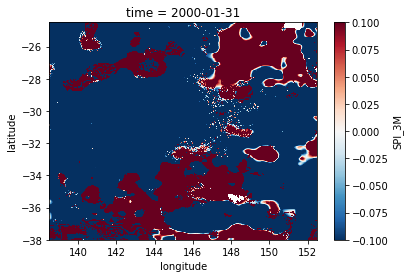

In [7]:
spi_3M.SPI_3M.isel(time=480).plot.imshow() # selection of time = 480

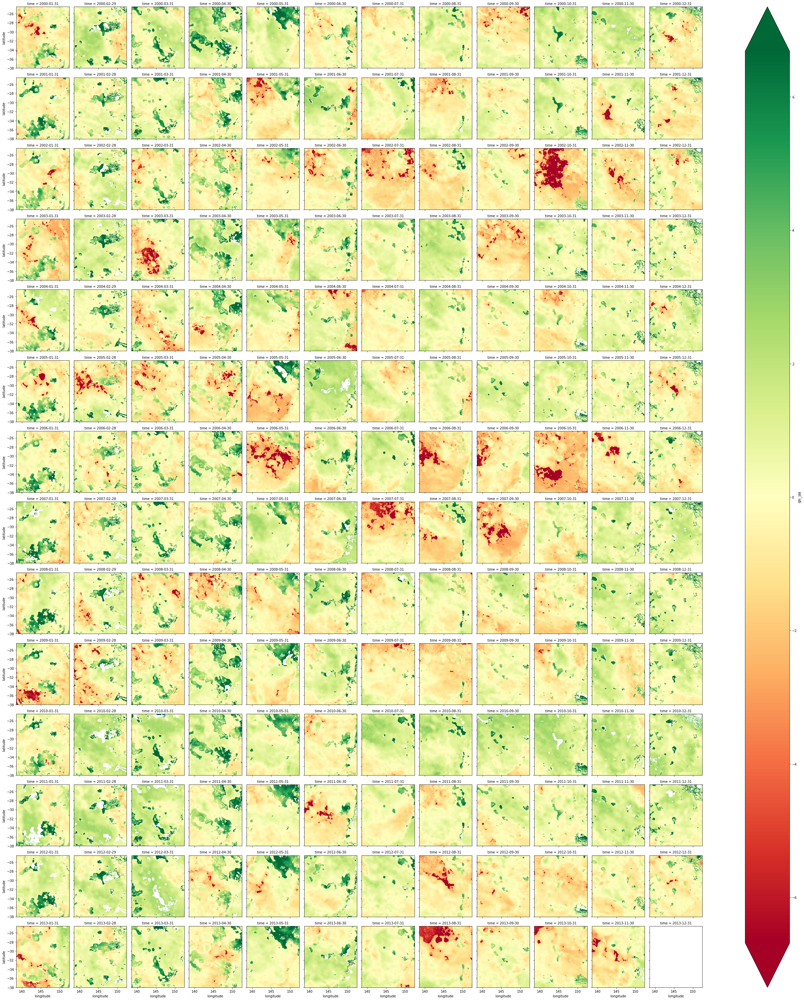

In [8]:
spi_3M.SPI_3M.isel(time=range(480,648)).plot.imshow(col='time', robust = True, col_wrap=12, cmap = 'RdYlGn')

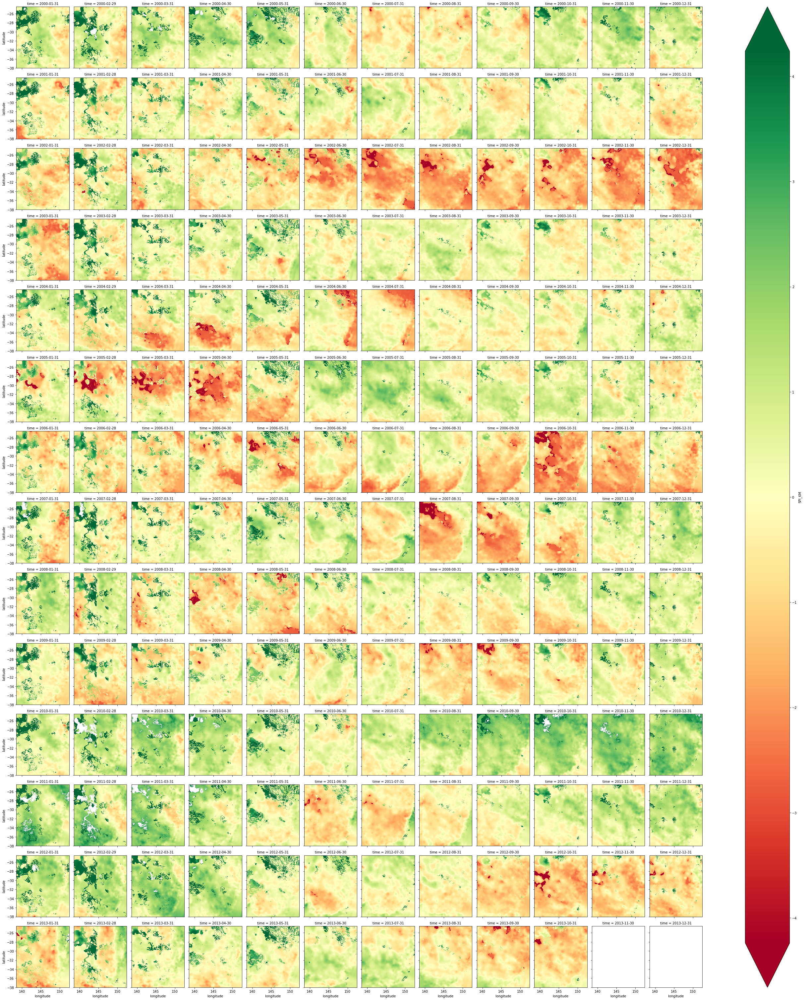

In [9]:
spi_6M.SPI_6M.isel(time=range(480,648)).plot.imshow(col='time', robust = True, col_wrap=12, cmap = 'RdYlGn')

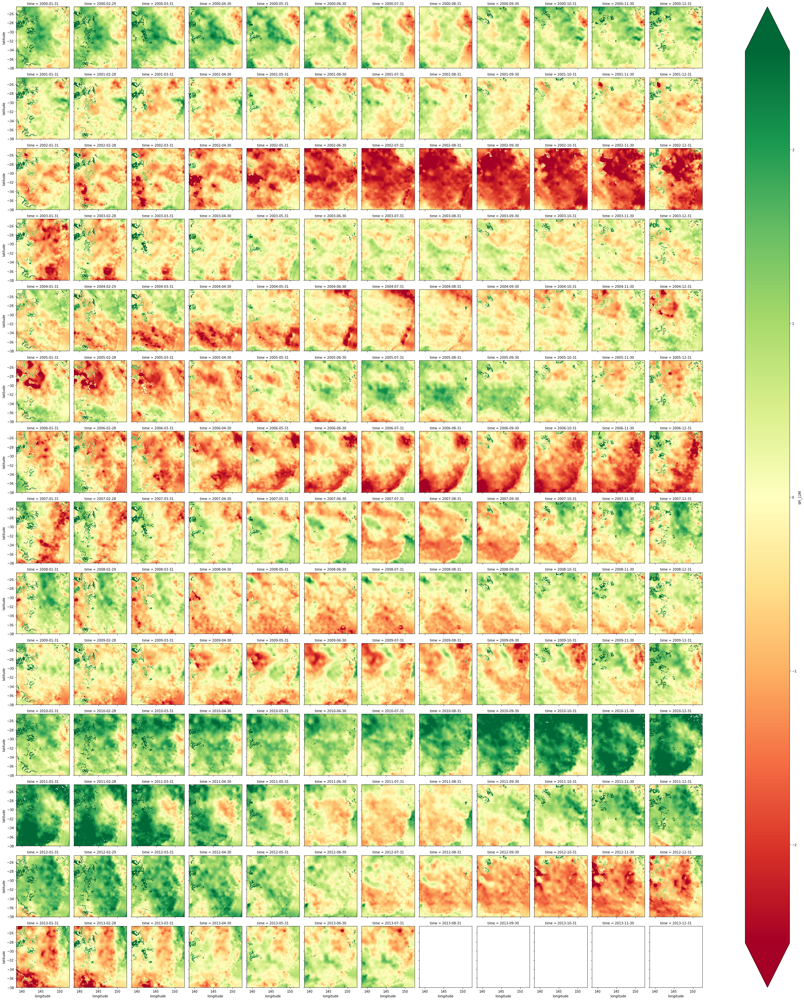

In [10]:
spi_12M.SPI_12M.isel(time=range(480,648)).plot.imshow(col='time', robust = True, col_wrap=12, cmap = 'RdYlGn')

### Masking shapefile

In [6]:
import fiona
import rasterio
import rasterio.mask

# create geometry coordinates of shapefile boundary 
# open the MDB shapefile 
with fiona.open("/home/563/sl1412/rainfall/mdb_boundary/mdb_boundary.shp", "r") as shapefile:
    geoms = [feature["geometry"] for feature in shapefile]
geoms

[{'coordinates': [[(146.88943187737294, -24.64027848277317),
    (146.88846192353657, -24.64262843314964),
    (146.88813201182728, -24.6451084706635),
    (146.89063199827063, -24.64569855664763),
    (146.89448180640278, -24.64440858174771),
    (146.89623178014932, -24.646038526640723),
    (146.89783188546704, -24.648238440950195),
    (146.90021184305687, -24.649868721119333),
    (146.90191169302244, -24.650628624461945),
    (146.90429165061227, -24.651228601091816),
    (146.9067316226289, -24.652168715352843),
    (146.90829166244936, -24.65333866139912),
    (146.90946160849575, -24.65547872891989),
    (146.91051169332655, -24.657618628802595),
    (146.91282174584381, -24.65924874133367),
    (146.91451170516365, -24.660008644676225),
    (146.91677146626188, -24.660318607455963),
    (146.91872143221843, -24.660508709020178),
    (146.92097147030887, -24.662538638333046),
    (146.9220614529989, -24.665318747980905),
    (146.92318144290215, -24.66693863459011),
    (146.9

In [7]:
# mask the SPI raster based on geoms 
with rasterio.open("/g/data/oe9/project/team-drip/Rainfall/SPI_12M_Layer1.tif") as src:
    out_image, out_transform = rasterio.mask.mask(src, geoms,
                                                        crop=True)
    out_meta = src.meta.copy()

In [8]:
out_meta

{'count': 1,
 'crs': CRS({'init': 'epsg:4326'}),
 'driver': 'GTiff',
 'dtype': 'float64',
 'height': 270,
 'nodata': 1.0,
 'transform': Affine(0.05000000000000071, 0.0, 138.5,
       0.0, -0.05000000000000071, -24.499999999999808),
 'width': 280}

In [9]:
out_transform # Affine transform variable used for rasterise the geoms 

Affine(0.05000000000000071, 0.0, 138.55000000000001,
       0.0, -0.05000000000000071, -24.549999999999809)

In [10]:
shape_data = spi_3M.SPI_3M.isel(time=0).shape
shape_data # shape of the raster (no. of col and no. of rows)

(270, 280)

In [12]:
# create masking array 
mask = xr.DataArray(
    features.rasterize(geoms, out_shape=shape_data, transform=out_transform, all_touched= False),
    coords=spi_3M.SPI_3M.isel(time=0).coords,
)
mask

NameError: name 'features' is not defined

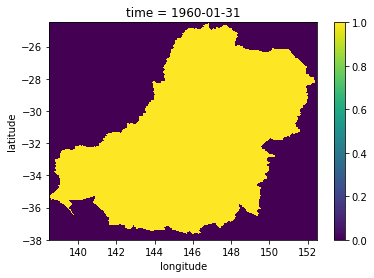

In [206]:
mask.plot.imshow()

In [147]:
import rasterio
from rasterio.mask import mask
import rasterio.features
from shapely.geometry import shape
# read the shape file and create the geometry data

with fiona.open(shape_file, 'r') as vector:
    
    for feature in vector:
        # create a shapely geometry
        # this is done for the convenience for the .bounds property only
        geometry = shape(feature['geometry'])

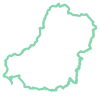

In [148]:
geometry.boundary

In [116]:
# def get_geot(ds):
#     """Take an Xarray object with x and y coords; return geotransform."""
#     return rasterio.Affine(*[float(i) for i in (
#         # Affine matrix - start/step/rotation, start/rotation/step - in 1D
#         ds.longitude[0], (ds.longitude[-1] - ds.longitude[0]) / ds.longitude.size, 0,
#         ds.latitude[0], 0, (ds.latitude[-1] - ds.latitude[0]) / ds.latitude.size
# )])

In [208]:
subset = spi_3M.where(mask, drop=True)
subset

<xarray.Dataset>
Dimensions:    (latitude: 261, longitude: 278, time: 648)
Coordinates:
  * latitude   (latitude) float64 -24.57 -24.62 -24.67 -24.72 -24.77 -24.82 ...
  * longitude  (longitude) float64 138.5 138.6 138.6 138.7 138.7 138.8 138.8 ...
  * time       (time) datetime64[ns] 1960-01-31 1960-02-29 1960-03-31 ...
Data variables:
    SPI_3M     (latitude, longitude, time) float64 nan nan nan nan nan nan ...

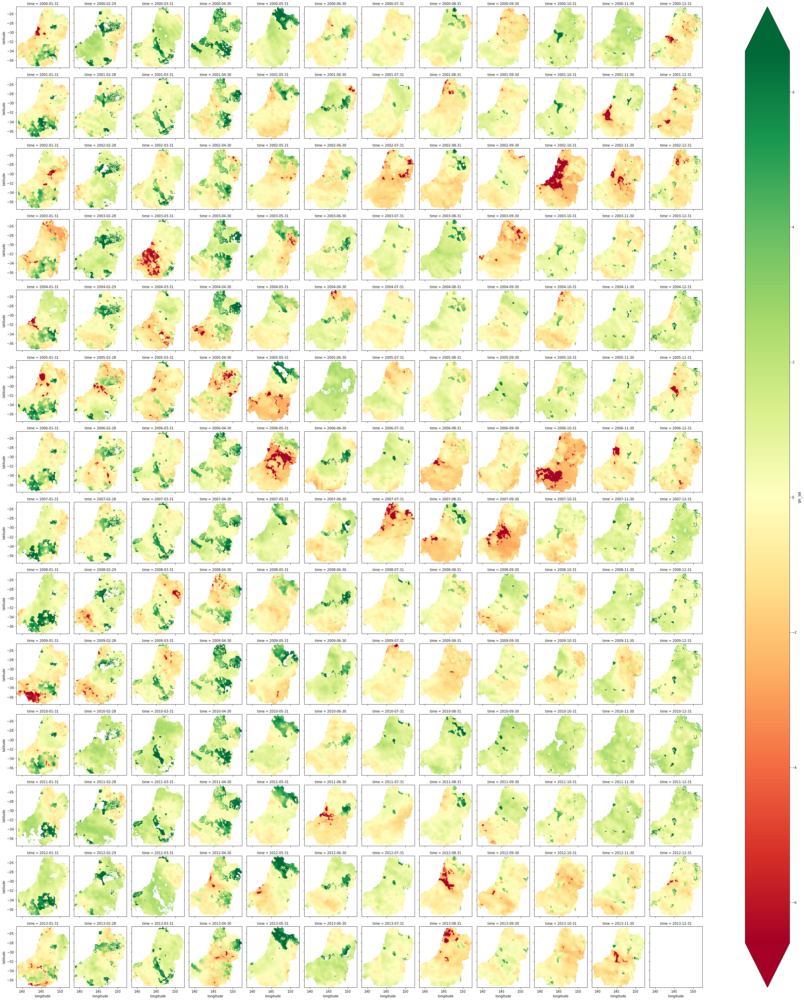

In [210]:
subset.SPI_3M.isel(time=range(480,648)).plot.imshow(col='time', robust = True, col_wrap=12, cmap = 'RdYlGn')

### Compare different time-scale SPI 

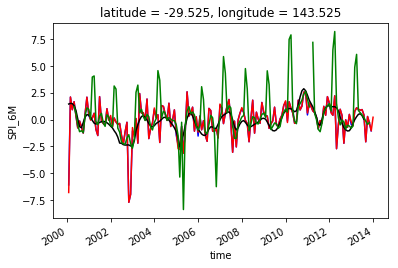

In [211]:
# compare different time-scale SPI at the same location (one pixel)
_lat, _lon = 100, 100
time_bounds = range(480,648)
# To plot two lines on the same axes, we have to explicitly create and use a set of axes 
# For the second, `ax.twinx()` creates a clone of the axes with a shared x and independent y.
fig, ax = plt.subplots()
spi_3M.SPI_3M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='blue')
spi_1M.SPI_1M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='red')
spi_12M.SPI_12M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='black')
spi_6M.SPI_6M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='green')

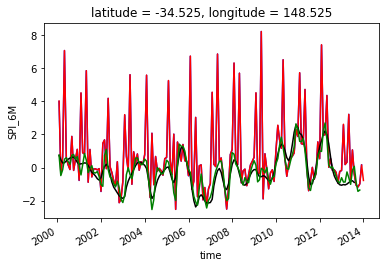

In [212]:
# Try a few different values to see if the relationship holds
_lat, _lon = 200, 200
time_bounds = range(480,648)
# To plot two lines on the same axes, we have to explicitly create and use a set of axes 
# For the second, `ax.twinx()` creates a clone of the axes with a shared x and independent y.
fig, ax = plt.subplots()
spi_3M.SPI_3M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='blue')
spi_1M.SPI_1M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='red')
spi_12M.SPI_12M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='black')
spi_6M.SPI_6M.isel(latitude=_lat, longitude=_lon,time=time_bounds).plot(ax=ax, color='green')